In [2]:
import pandas as pd
import matplotlib.pyplot as plt

from PIL import Image

from rec.utils import draw_bounding_boxes

In [6]:
BASE_PATH = "../code/rec/"

In [80]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

### Read validation data

In [4]:
df_valid_results = pd.read_parquet("../models/exp_004/predictions_val.parquet")

In [5]:
df_valid_results.head()

,bbox_raw,bbox_pred,img_filename,expr,hits,spatial,ordinal,relational,intrinsic
0,"[156.0, 169.0, 224.0, 360.0]","[49.481747, 99.540726, 301.4215, 272.09885]",refer/data/images/saiapr_tc-12/10/images/10890...,person on the left,0.0,1,0,0,0
1,"[0.0, 94.0, 480.0, 360.0]","[62.72489, 94.11238, 340.92255, 246.16074]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,the trees,0.0,0,0,0,1
2,"[110.0, 64.0, 296.0, 183.0]","[65.14025, 65.82784, 359.55045, 232.00388]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,sky next to clouds,0.0,1,0,1,0
3,"[201.0, 49.0, 331.0, 184.0]","[60.592358, 81.93651, 333.8043, 234.55069]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,clouds,0.0,0,0,0,1
4,"[176.0, 56.0, 478.0, 195.0]","[64.9345, 103.80368, 327.54202, 251.31976]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,mountain,0.0,0,0,0,1


In [61]:
df_valid_results.shape

(6333, 9)

In [58]:
df_valid_results_exp003 = pd.read_parquet("../models/exp_003/predictions_val.parquet")

In [62]:
df_valid_results_exp003.head()

,bbox_raw,bbox_pred,img_filename,expr,hits,spatial,ordinal,relational,intrinsic
0,"[156.0, 169.0, 224.0, 360.0]","[150.1989, 168.85612, 214.18504, 359.0]",refer/data/images/saiapr_tc-12/10/images/10890...,person on the left,1.0,1,0,0,0
1,"[0.0, 94.0, 480.0, 360.0]","[6.03527, 42.10663, 479.0, 359.0]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,the trees,1.0,0,0,0,1
2,"[110.0, 64.0, 296.0, 183.0]","[84.89125, 41.48004, 285.32928, 176.66406]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,sky next to clouds,1.0,1,0,1,0
3,"[201.0, 49.0, 331.0, 184.0]","[183.9086, 85.440216, 307.06946, 178.0696]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,clouds,1.0,0,0,0,1
4,"[176.0, 56.0, 478.0, 195.0]","[0.74645513, 0.0, 479.0, 359.0]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,mountain,0.0,0,0,0,1


In [74]:
df_valid_results = df_valid_results.join(df_valid_results_exp003.loc[:, ["bbox_pred"]], rsuffix='_exp003')

In [75]:
df_valid_results.head()

,bbox_raw,bbox_pred,img_filename,expr,hits,spatial,ordinal,relational,intrinsic,bbox_pred_exp003
0,"[156.0, 169.0, 224.0, 360.0]","[49.481747, 99.540726, 301.4215, 272.09885]",refer/data/images/saiapr_tc-12/10/images/10890...,person on the left,0.0,1,0,0,0,"[150.1989, 168.85612, 214.18504, 359.0]"
1,"[0.0, 94.0, 480.0, 360.0]","[62.72489, 94.11238, 340.92255, 246.16074]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,the trees,0.0,0,0,0,1,"[6.03527, 42.10663, 479.0, 359.0]"
2,"[110.0, 64.0, 296.0, 183.0]","[65.14025, 65.82784, 359.55045, 232.00388]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,sky next to clouds,0.0,1,0,1,0,"[84.89125, 41.48004, 285.32928, 176.66406]"
3,"[201.0, 49.0, 331.0, 184.0]","[60.592358, 81.93651, 333.8043, 234.55069]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,clouds,0.0,0,0,0,1,"[183.9086, 85.440216, 307.06946, 178.0696]"
4,"[176.0, 56.0, 478.0, 195.0]","[64.9345, 103.80368, 327.54202, 251.31976]",refer/data/images/saiapr_tc-12/03/images/3593.jpg,mountain,0.0,0,0,0,1,"[0.74645513, 0.0, 479.0, 359.0]"


exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
the sky with no clouds


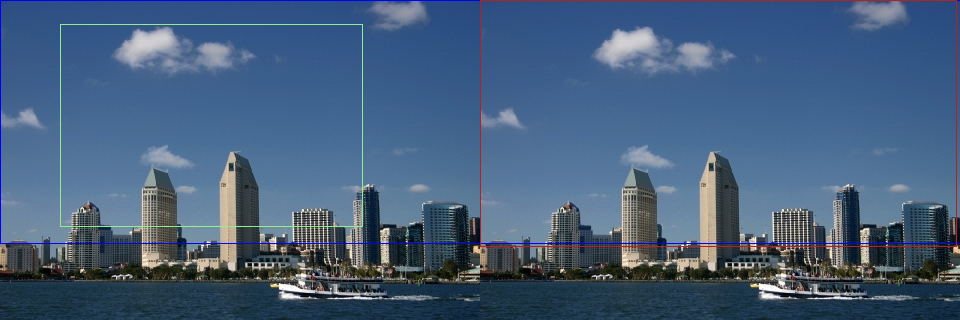

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
dirt at bottom


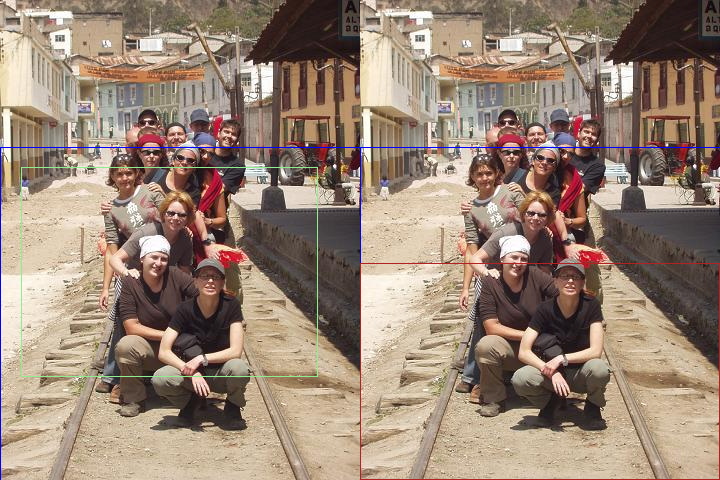

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
top bunk


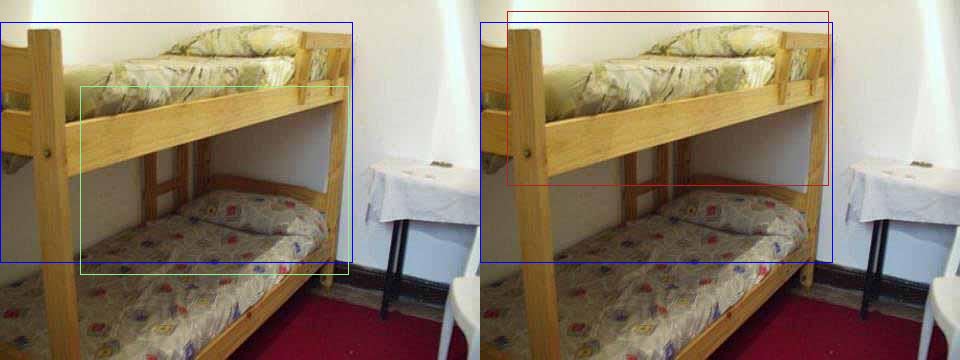

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
sandy bottom area


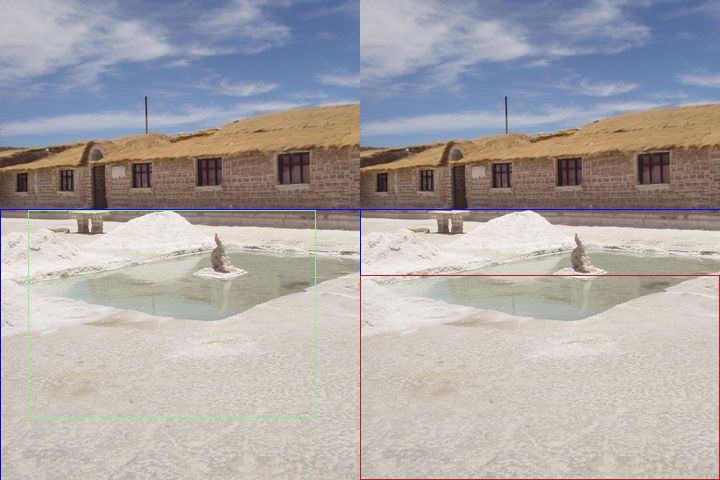

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
lady with white bra top


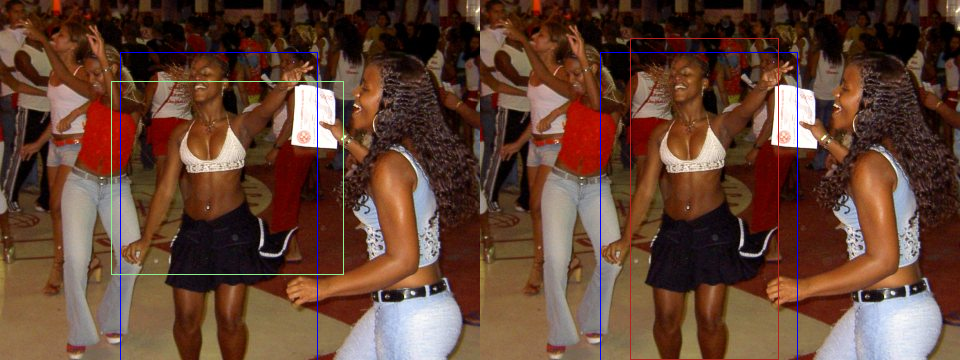

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
lit up buildings on left side middle


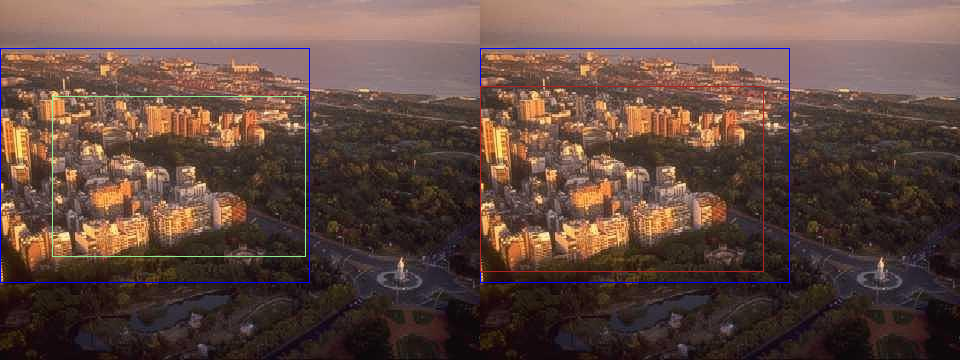

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
whitewater down the center of the falls


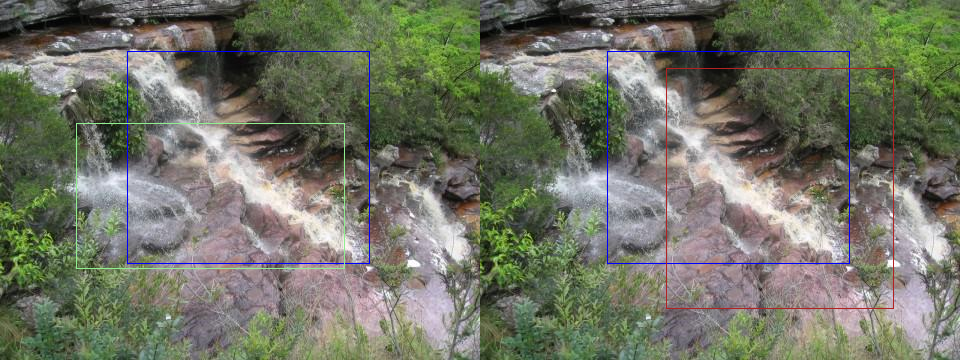

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
woman bancing in black skirt


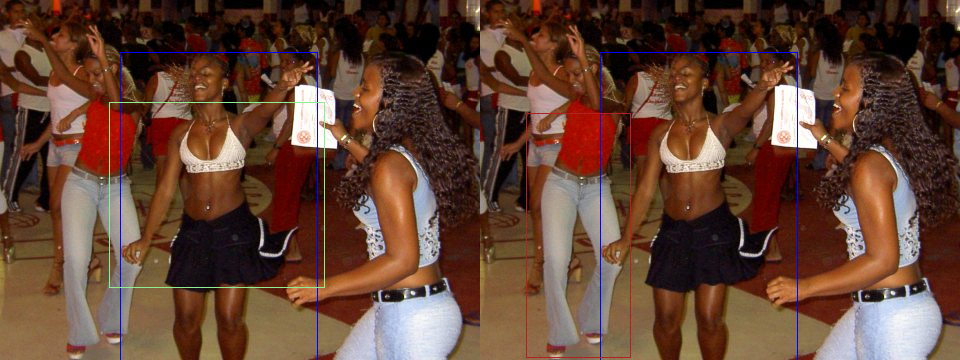

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
woman dancing in middle


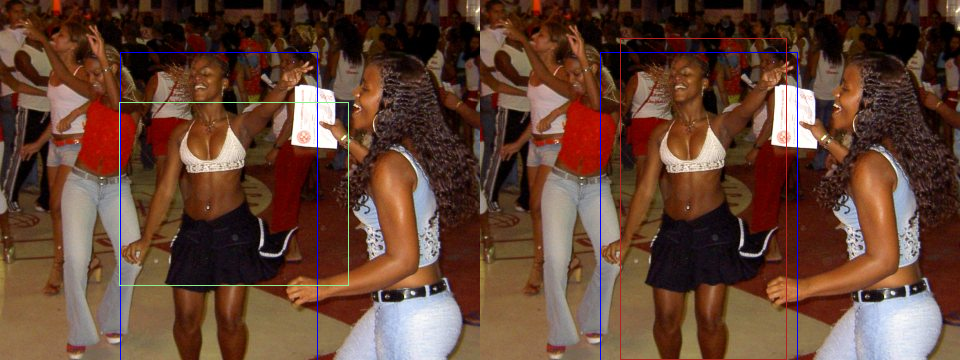

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=1.
the clouds in the center


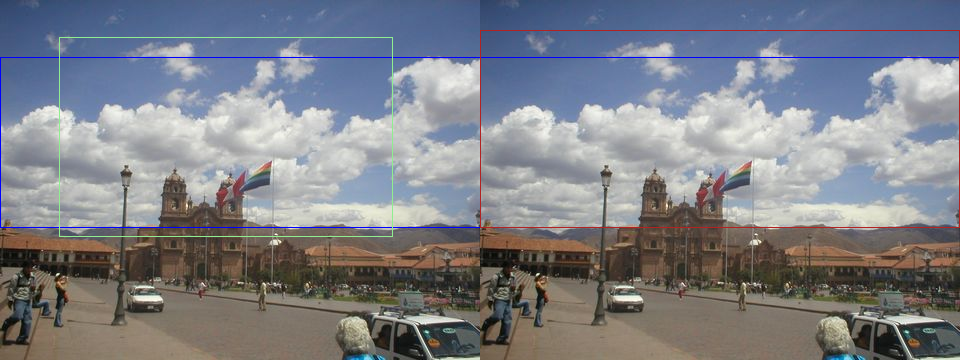

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=1.
first skeleton in front


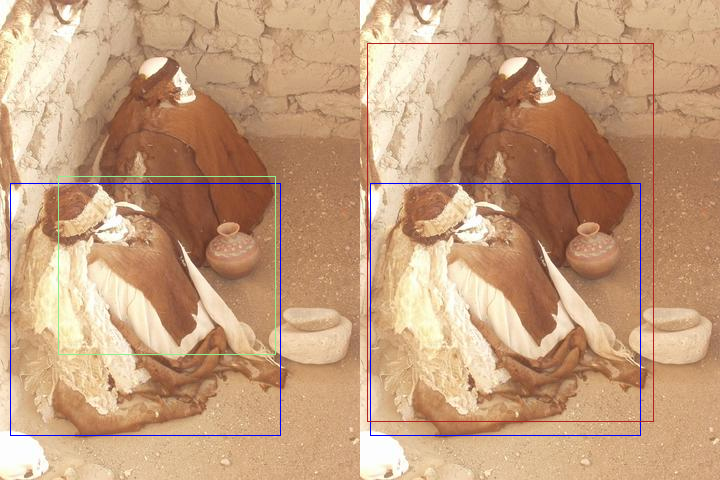

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=1.
first car on the right


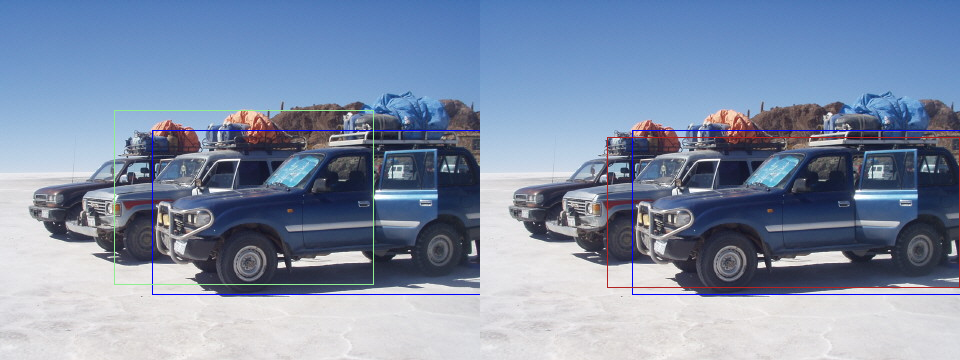

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
city line with clouds in the sky


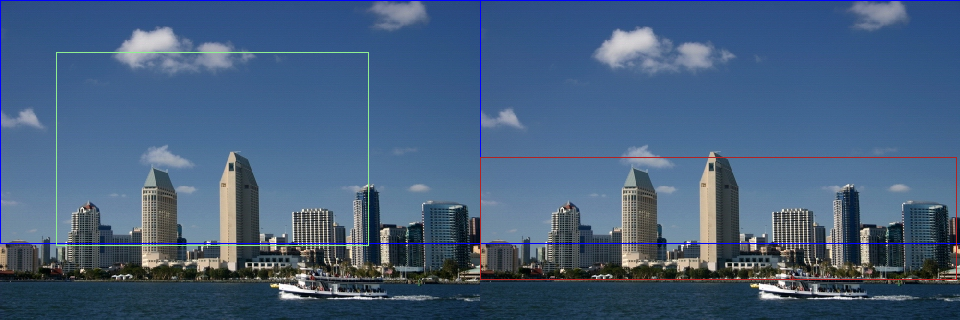

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
person in black skirt


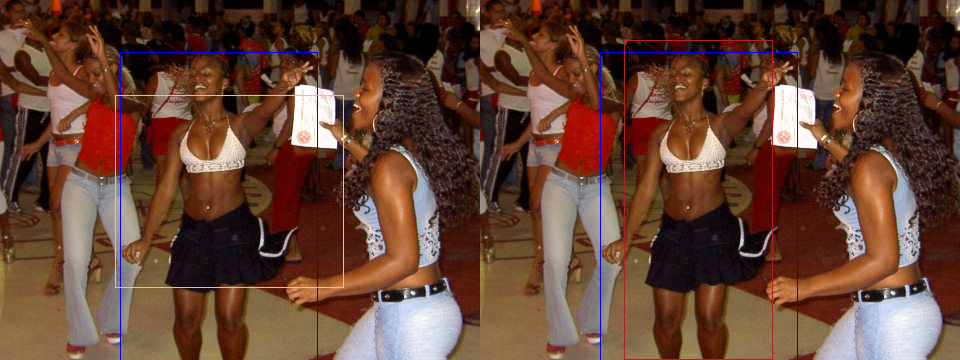

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
woman bancing in black skirt


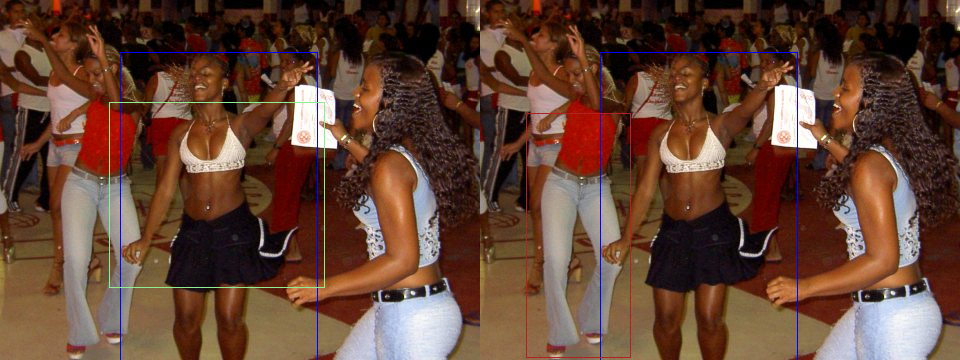

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
wood wall between mattresses


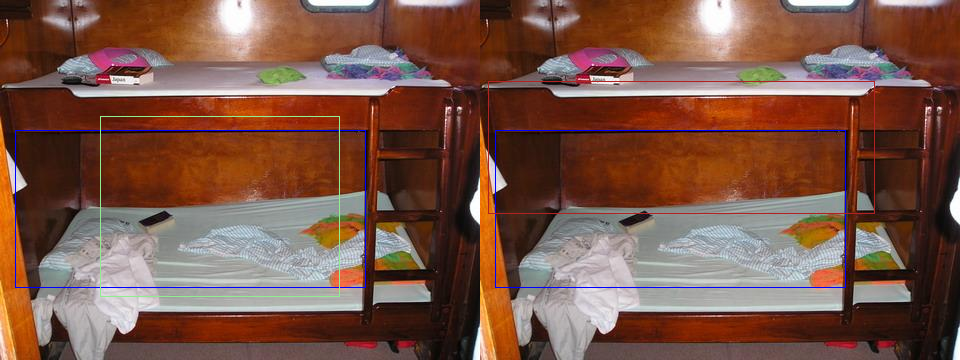

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
woman in black t-shirt


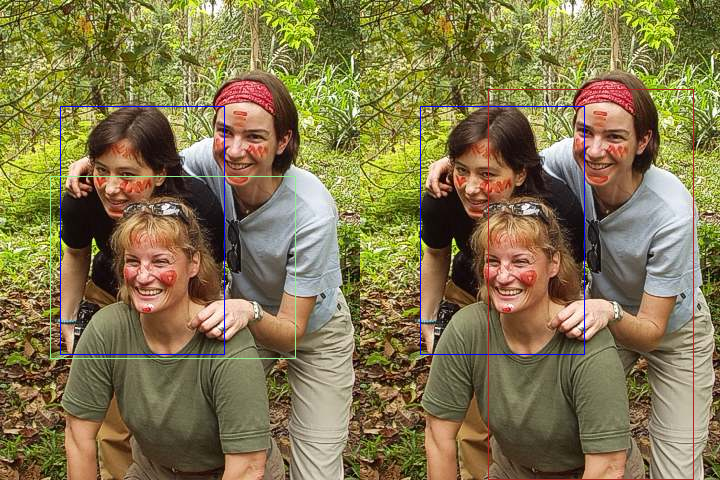

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
stones on left behind guy in blue


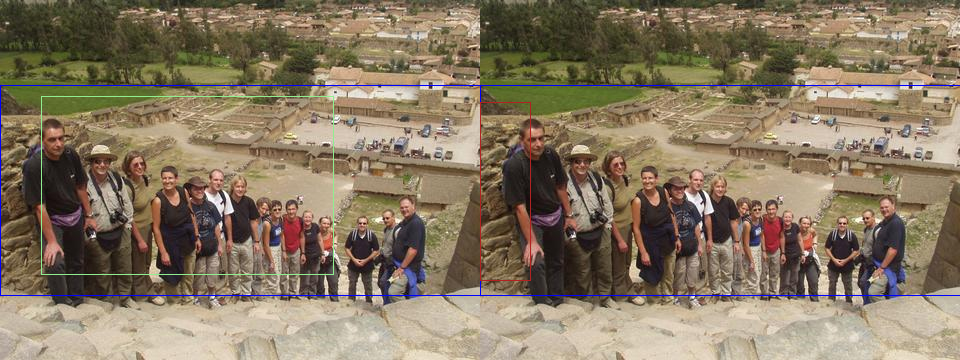

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
grassy area above branch


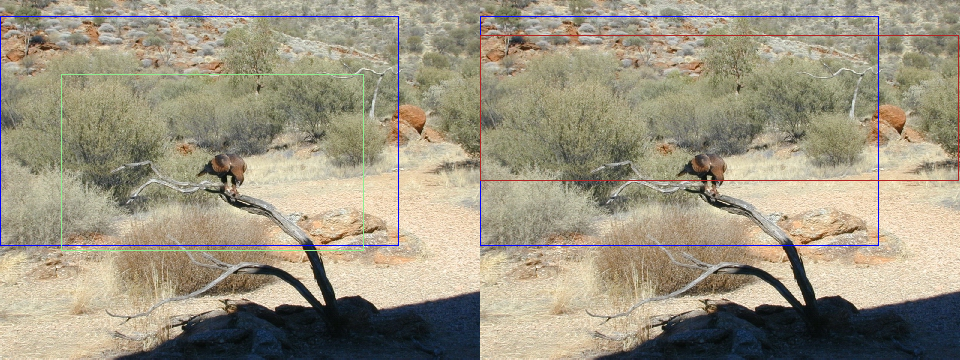

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
girl in bikini top


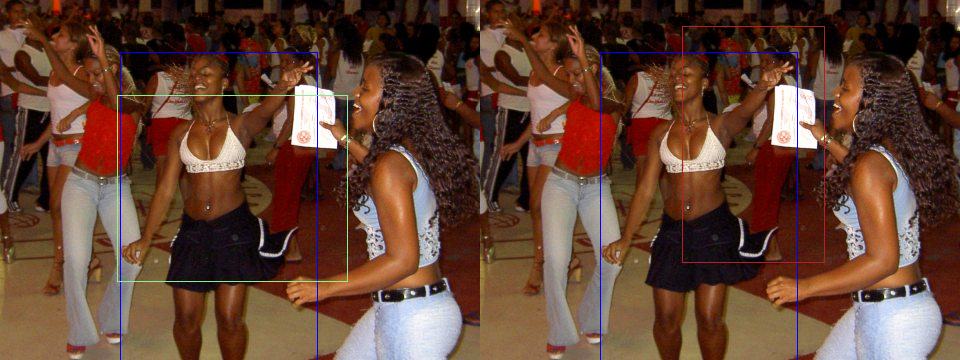

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
the water to the right of the lighthouse


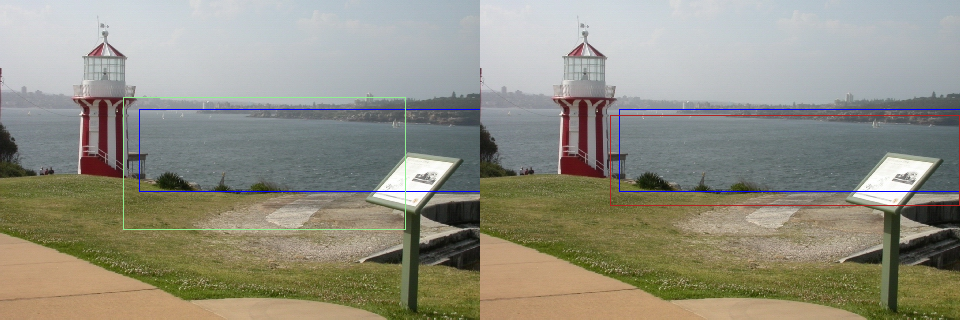

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=1.
the city lit by sunlight


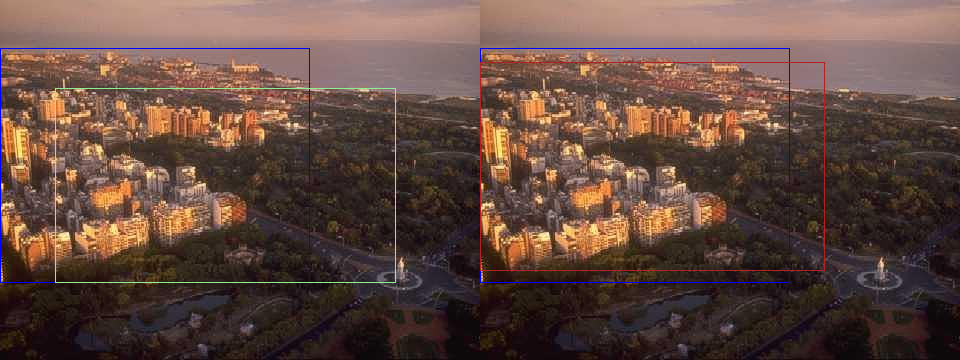

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
statue


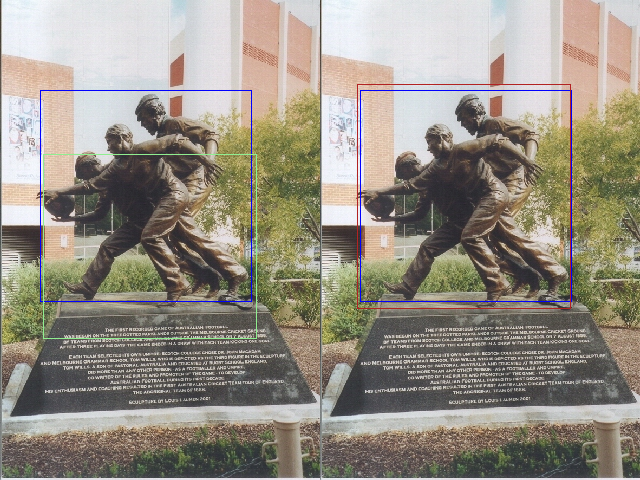

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
kids fave


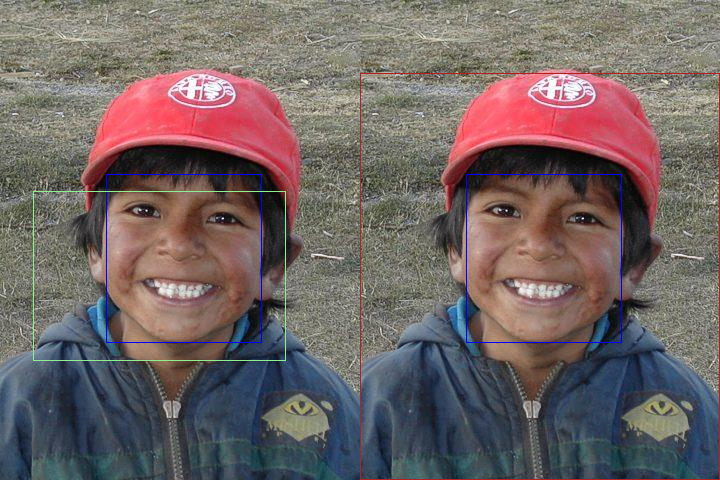

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
menu


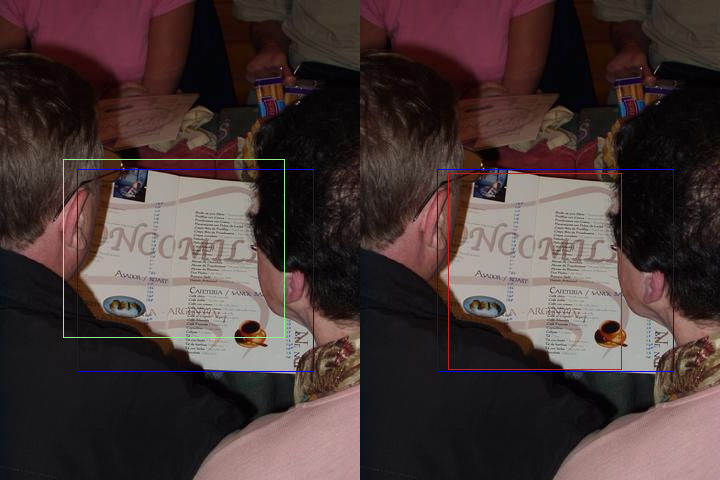

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
people


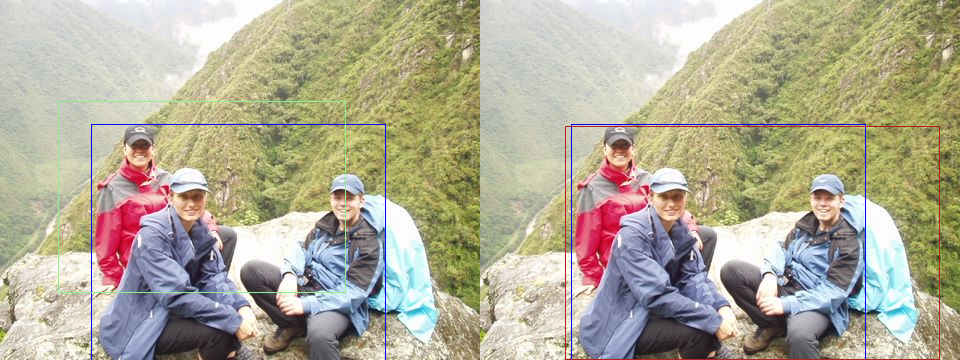

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
white bra girl


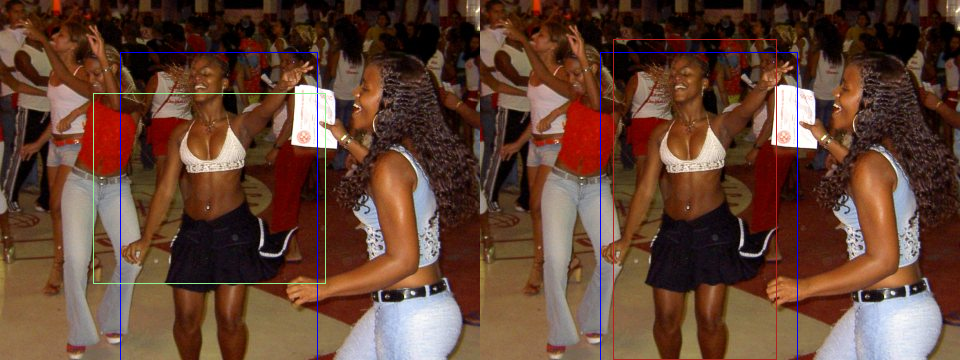

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
bed


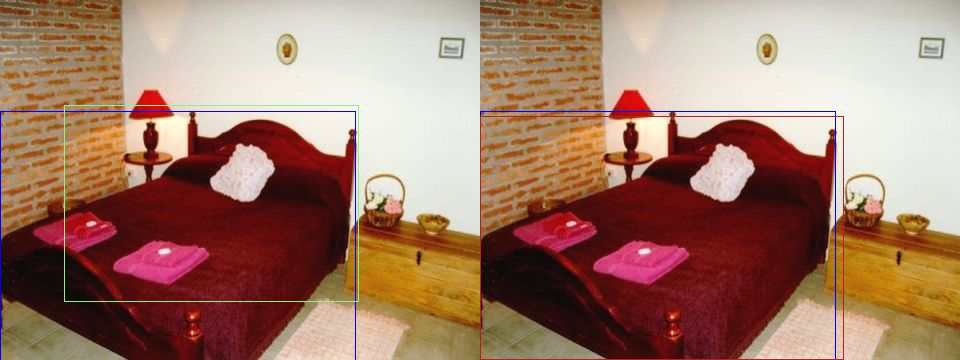

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
bird


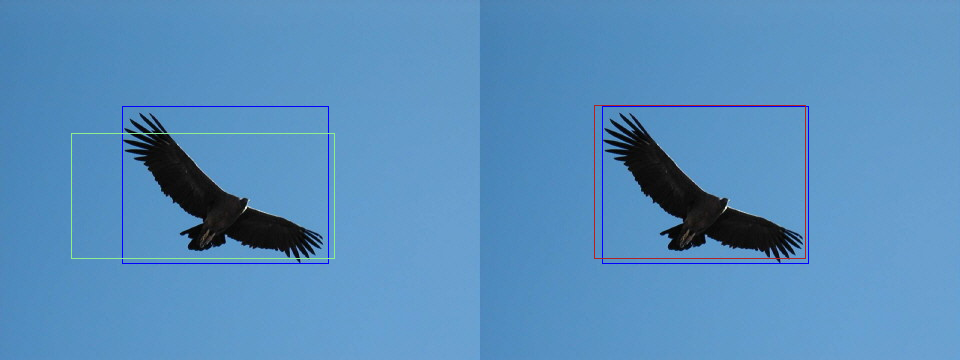

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
roof


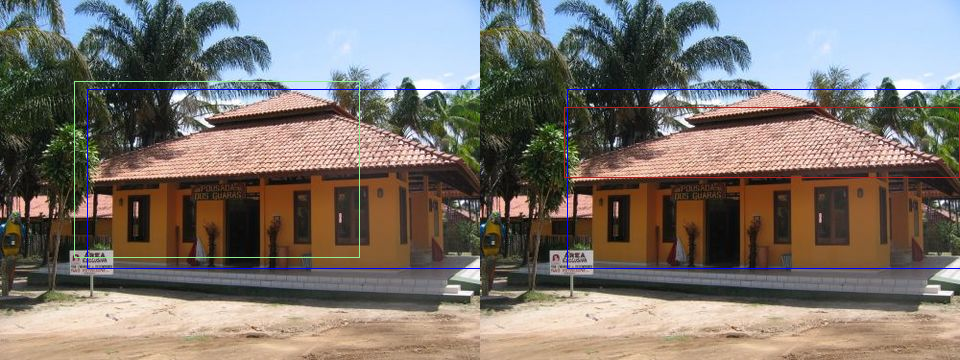

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
people


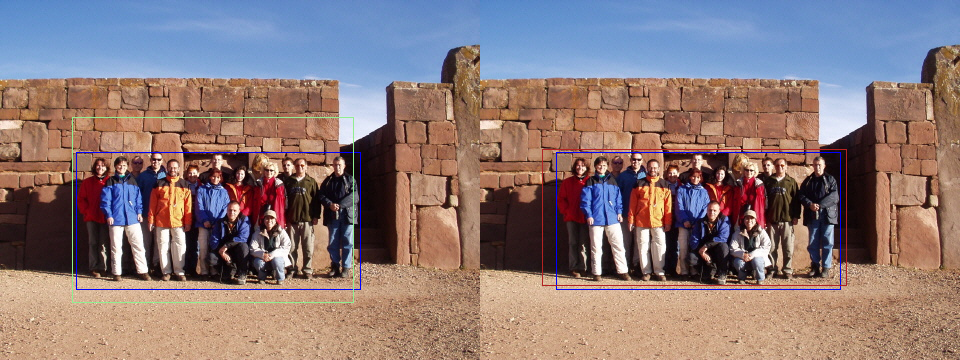

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=1.
sky


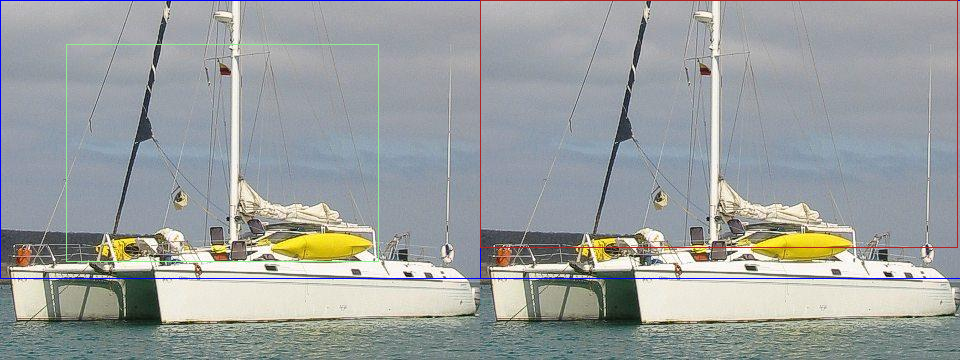

In [82]:
for rec_cls in ["spatial", "ordinal", "relational", "intrinsic"]:
    mask_counts = df_valid_results[rec_cls] == 1
    mask_hits = df_valid_results["hits"] == 1
    size_rec_cls_hits = df_valid_results[mask_counts & mask_hits].shape[0]
    df_sample_cls = (
        df_valid_results[mask_counts & mask_hits].sample(
            min(10, size_rec_cls_hits), random_state=42
        )
    )
    for _, row in df_sample_cls.loc[:, ["bbox_raw", "bbox_pred", "bbox_pred_exp003", "img_filename", "expr"]].iterrows():
        im = Image.open(f"{BASE_PATH}{row['img_filename']}")
        im = draw_bounding_boxes(im, [row['bbox_raw']], fmt="xyxy", color="blue")
        im2 = im.copy()
        im = draw_bounding_boxes(im, [row['bbox_pred']], fmt="xyxy", color="lightgreen")
        im2 = draw_bounding_boxes(im2, [row['bbox_pred_exp003']], fmt="xyxy", color="firebrick")
        print(f"exp004 (left, green) and exp003 (right, red) comparision. {rec_cls.upper()}. HITS=1.")
        print(row['expr'])
        get_concat_h(im, im2).show()

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
man on the left facing camera


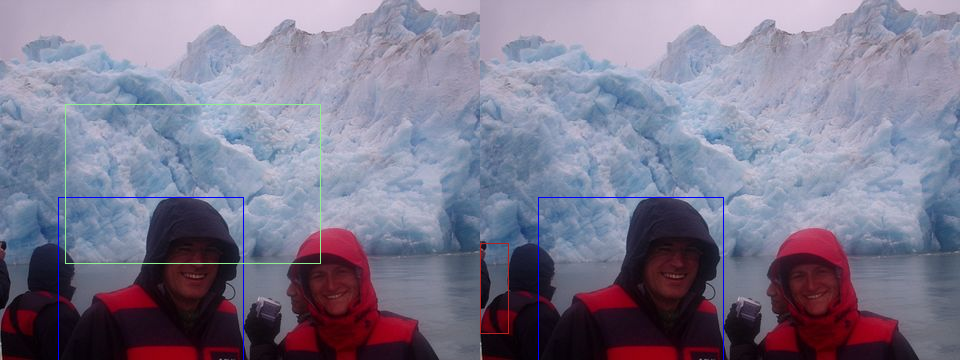

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
second water bottle from top left shelf


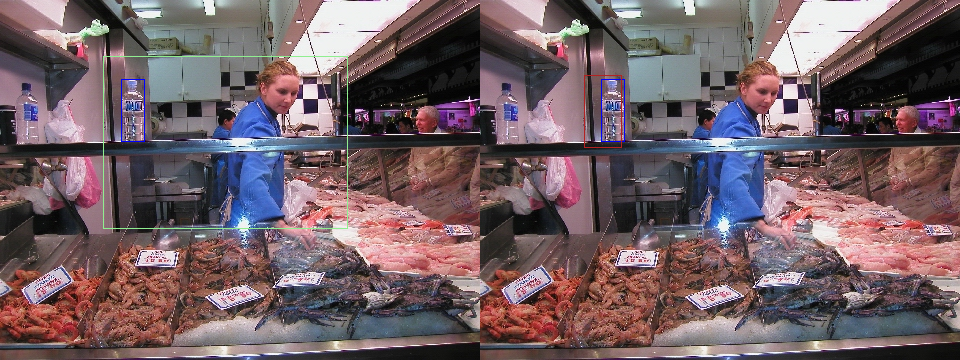

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
right , bottom , not people


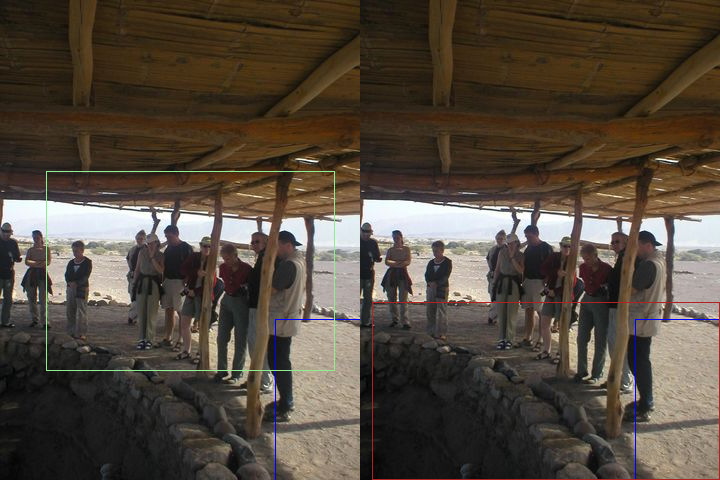

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
top of pic


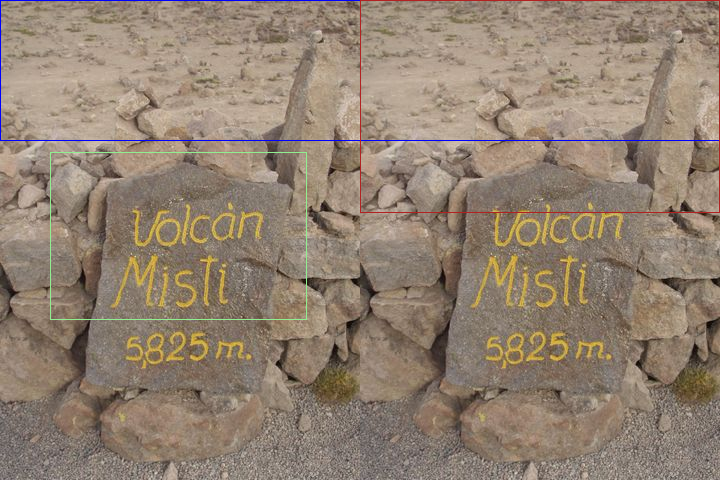

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
top book shelf second in from the left


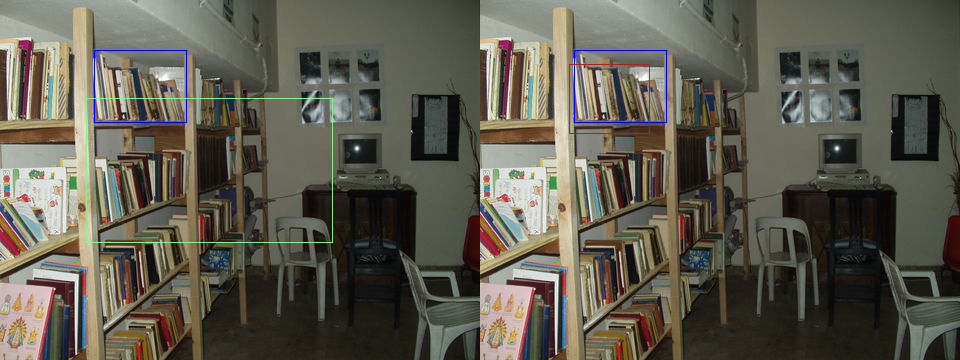

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
water on right of girls hair


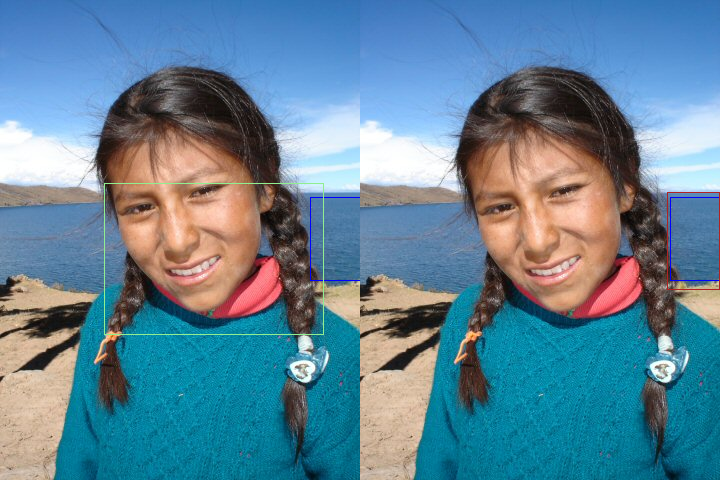

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
the grass on the direct right side of the picture


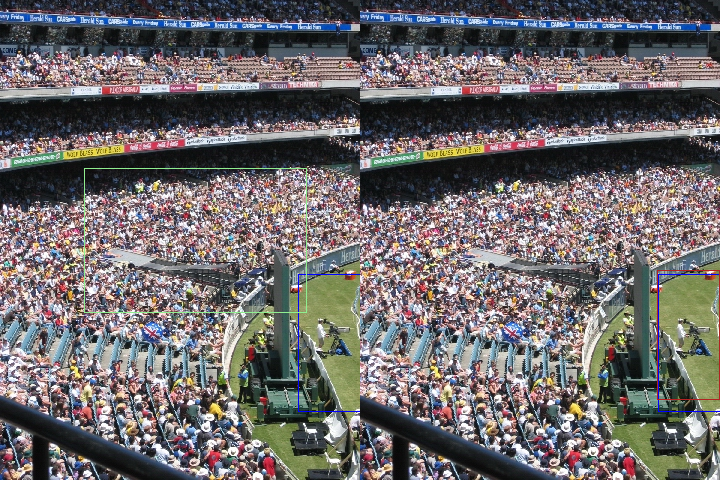

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
bottom half of city


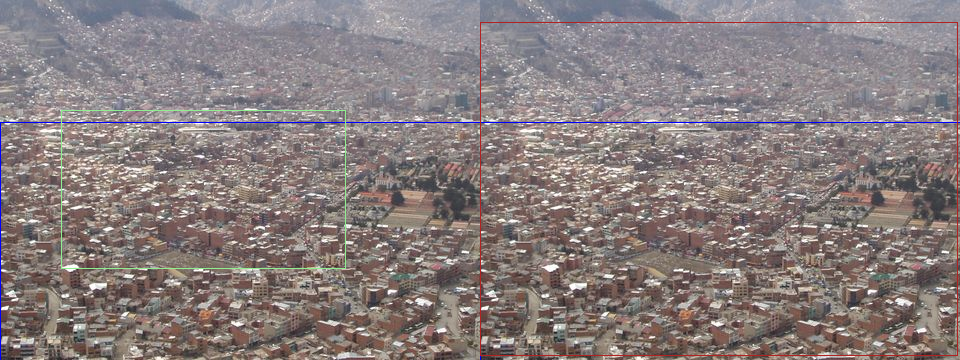

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
no image on the last one , sorry , panda


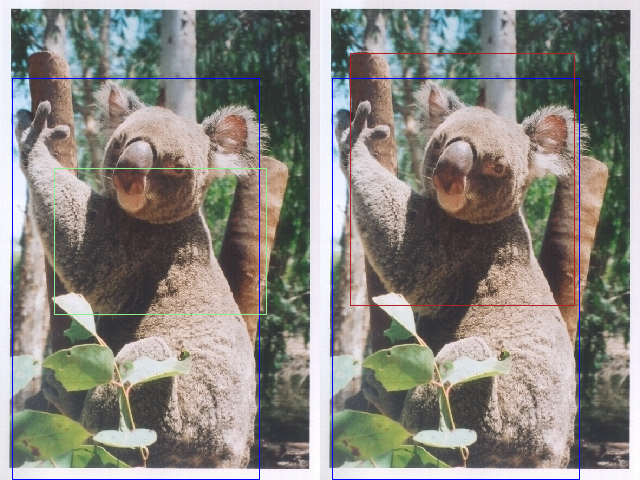

exp004 (left, green) and exp003 (right, red) comparision. SPATIAL. HITS=0.
tree to the left of the cross


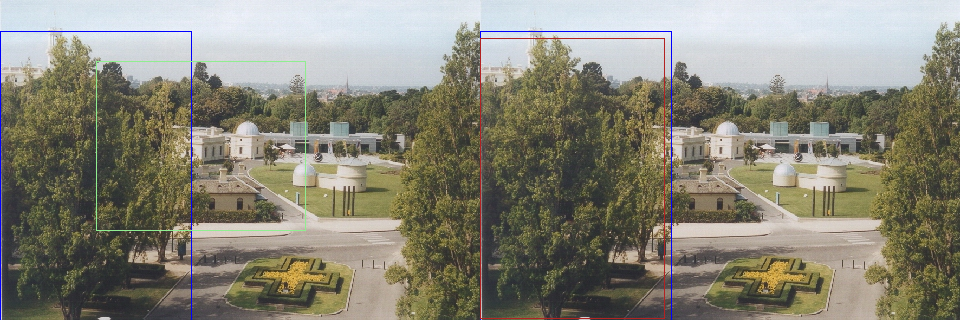

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
first row on right with 4 pictures in the row


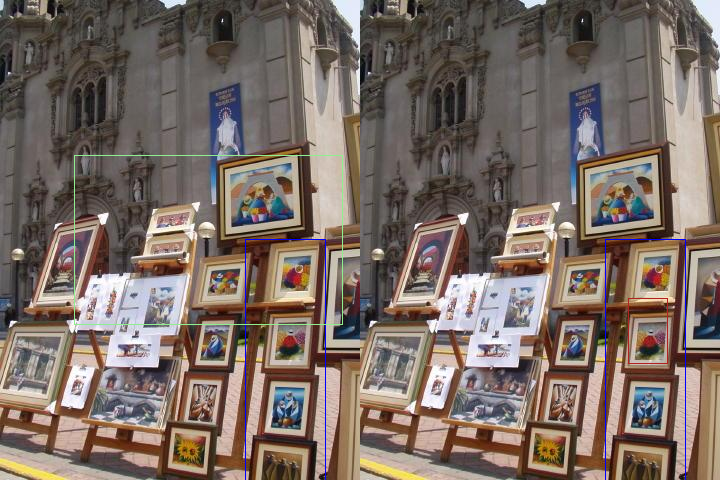

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
second man


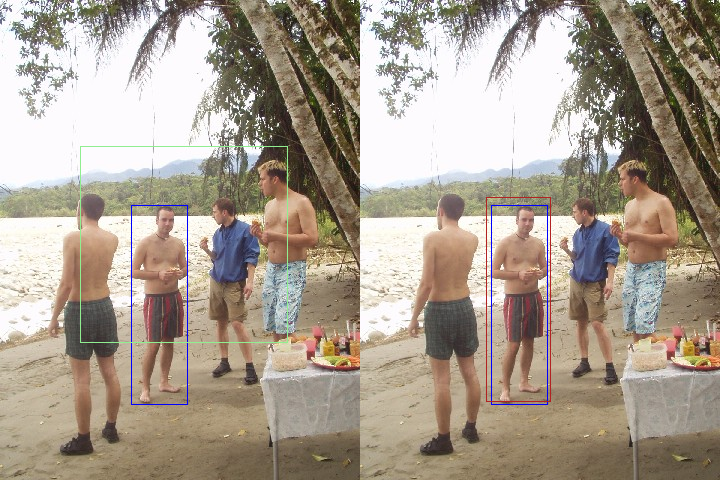

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
sorry could n't see first pic , any of the people on right , woman in reddish shirt , man next to her in white


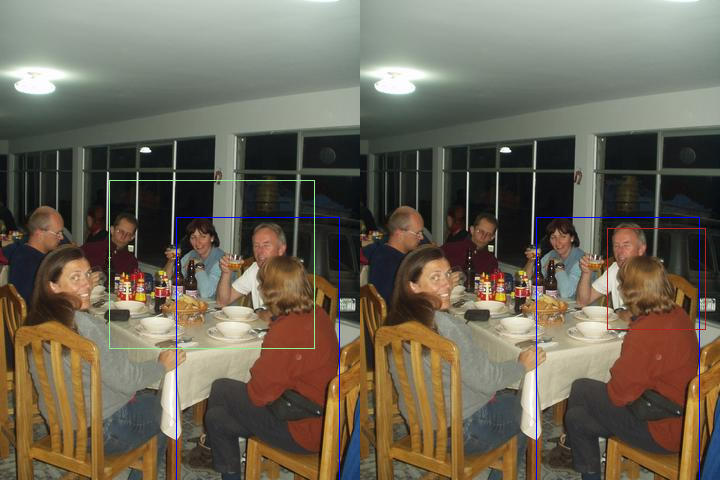

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
people above the third bench


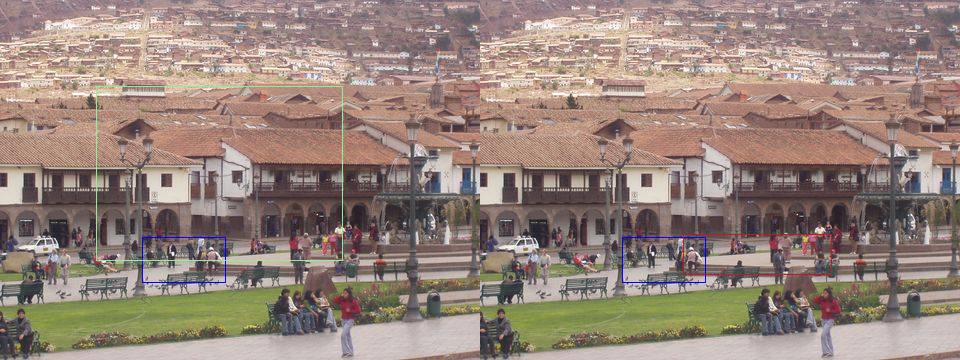

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
you had it , car right side first one


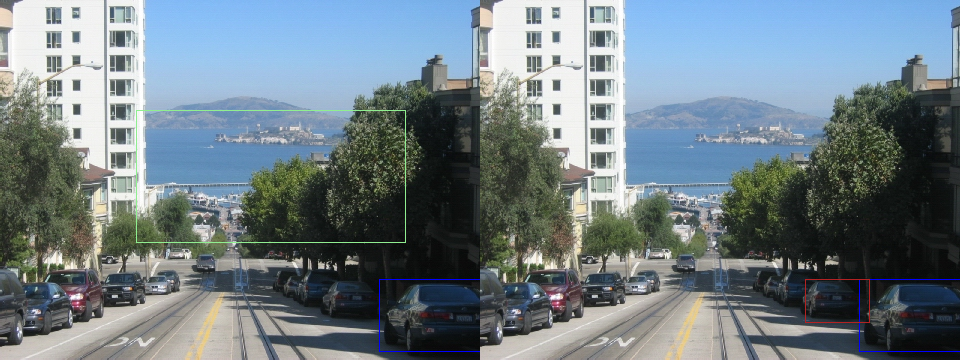

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
2nd row of books from the ground in the front has black books


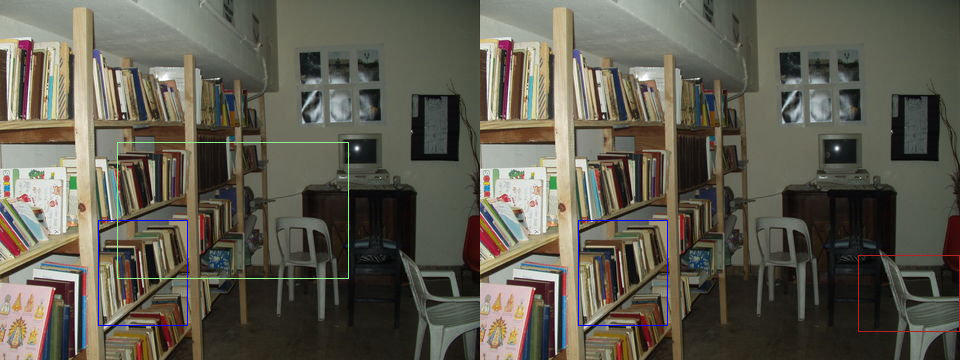

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
2nd person on left a lady


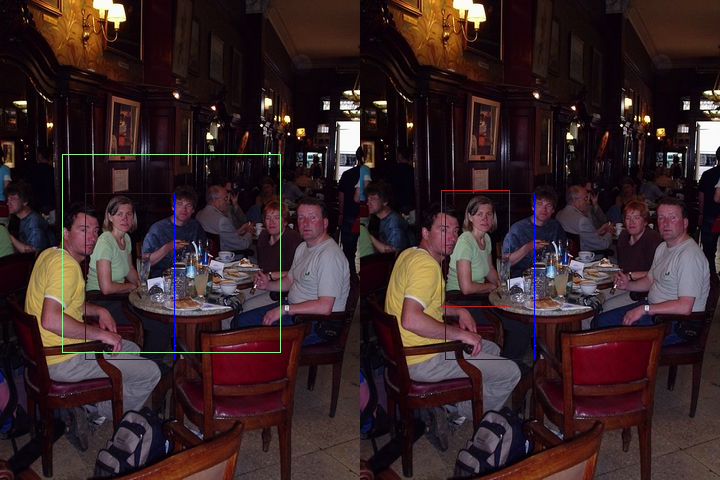

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
second bottle on left


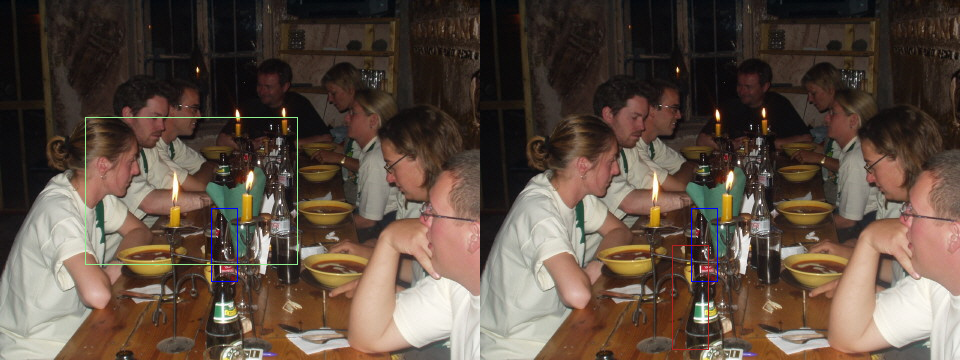

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
second man from left


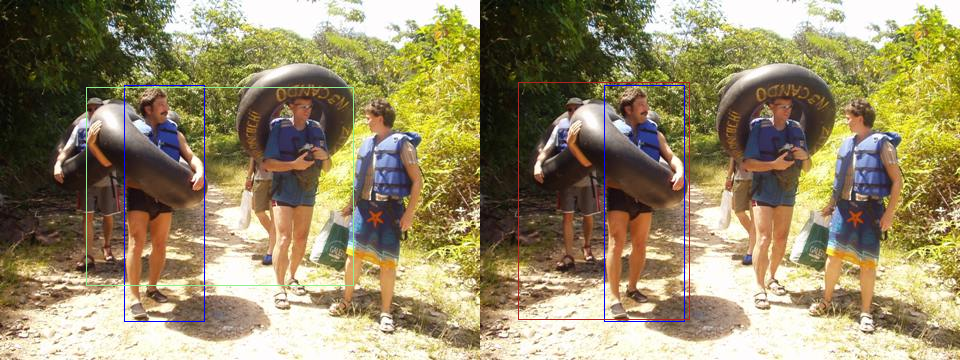

exp004 (left, green) and exp003 (right, red) comparision. ORDINAL. HITS=0.
full row of books , 2nd row up from bottom first full row


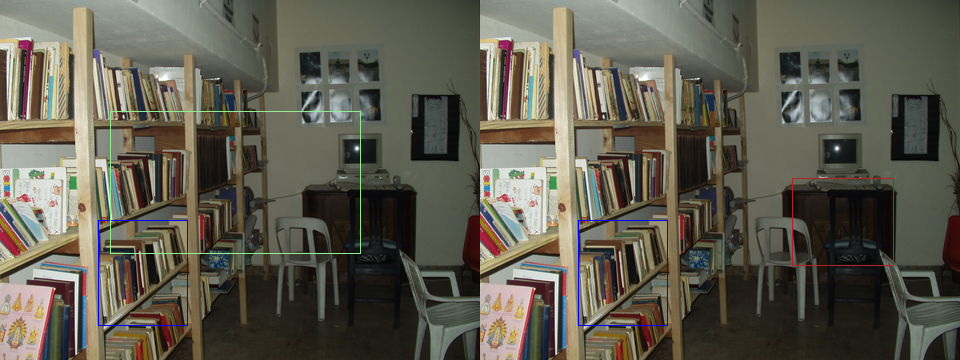

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
lightspace out windows


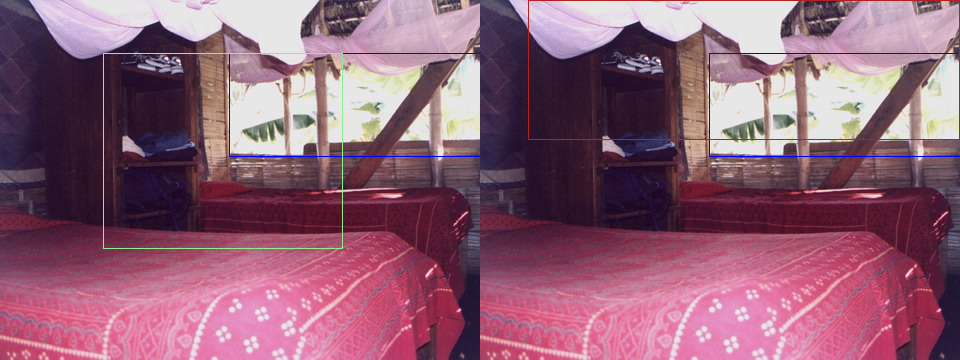

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
person sitting in the middle with the big hat on


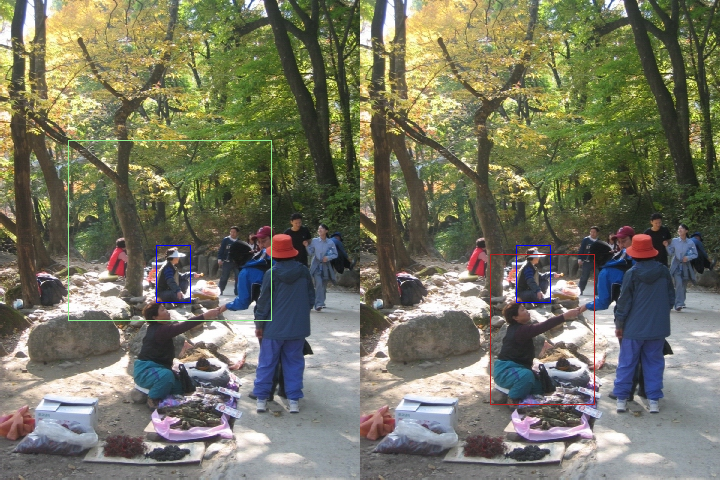

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
dirt pile above right sign


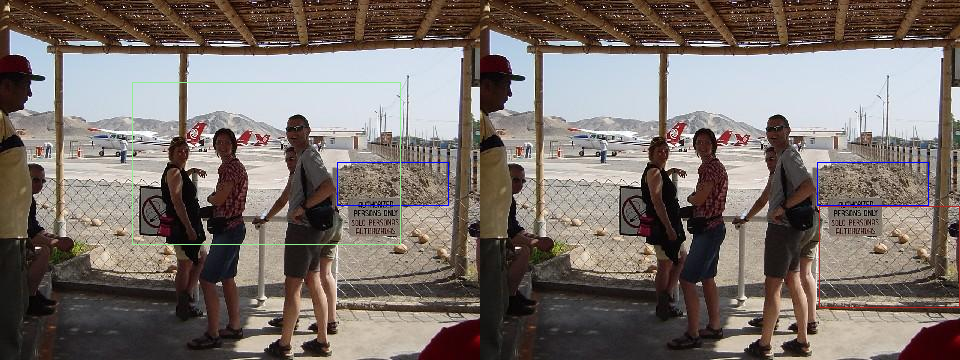

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
area of land bottom left


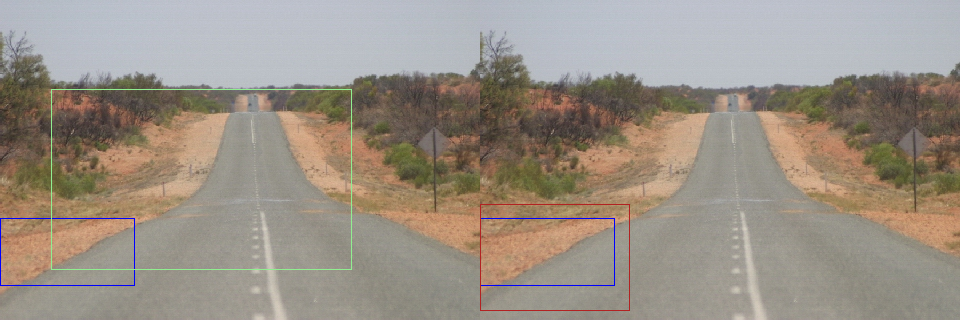

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
blonde girl 's face on right , in black hat


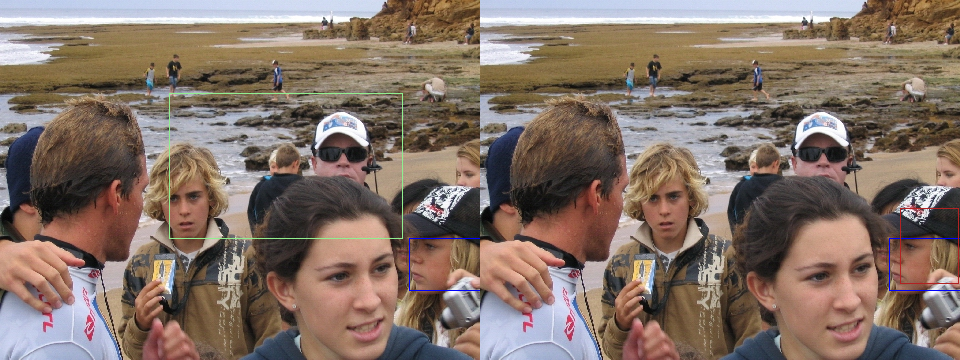

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
sidewalk right of green car


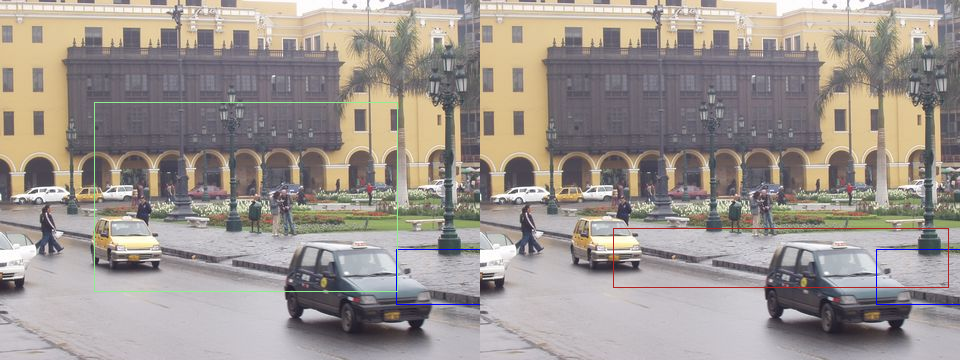

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
middle tree beside beige building


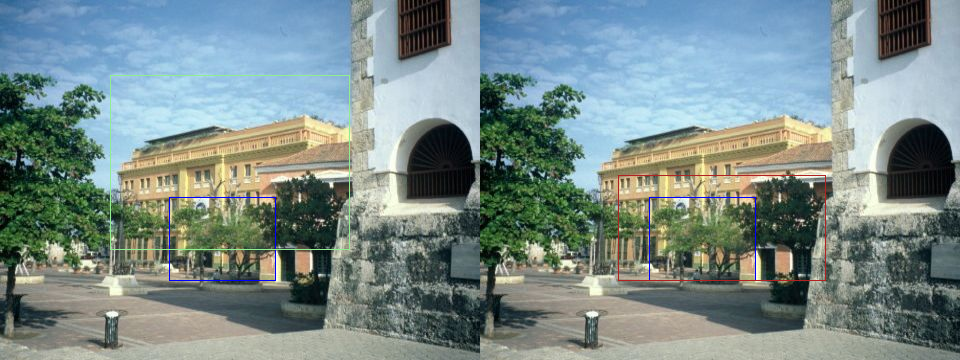

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
picture on wall


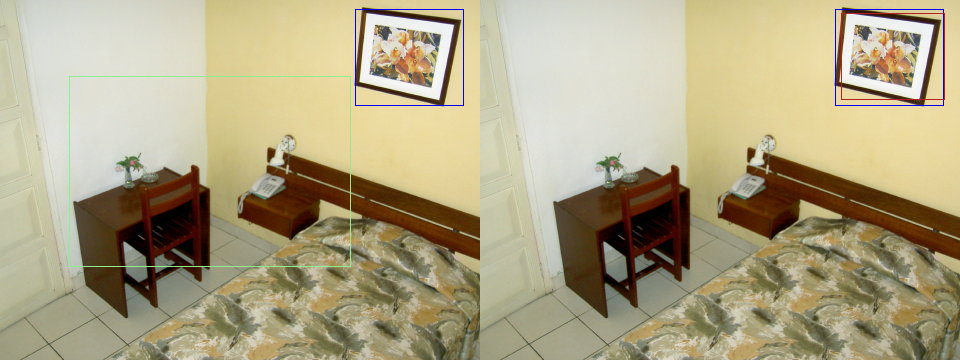

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
the rock to the right of the boy , the one you can see the whole thing


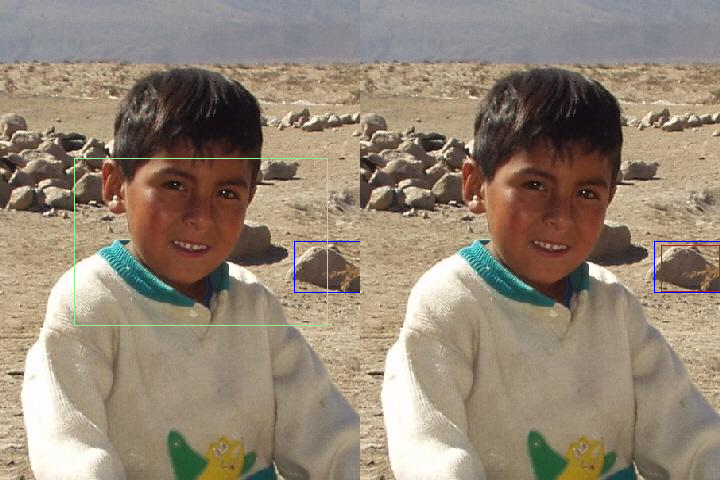

exp004 (left, green) and exp003 (right, red) comparision. RELATIONAL. HITS=0.
left horse with rider


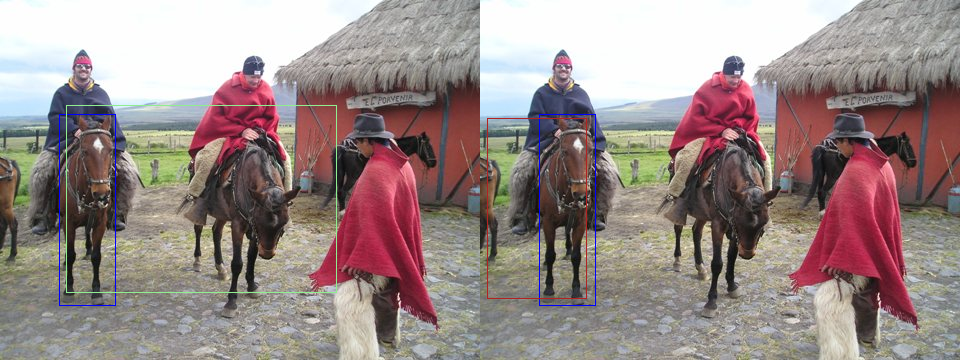

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
fountain


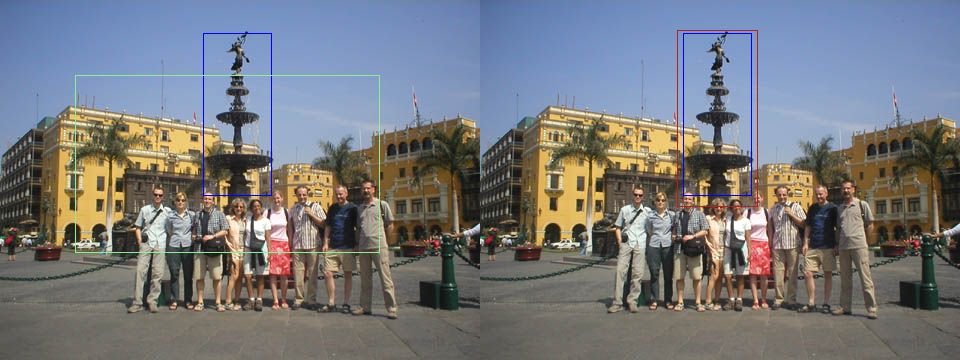

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
the window


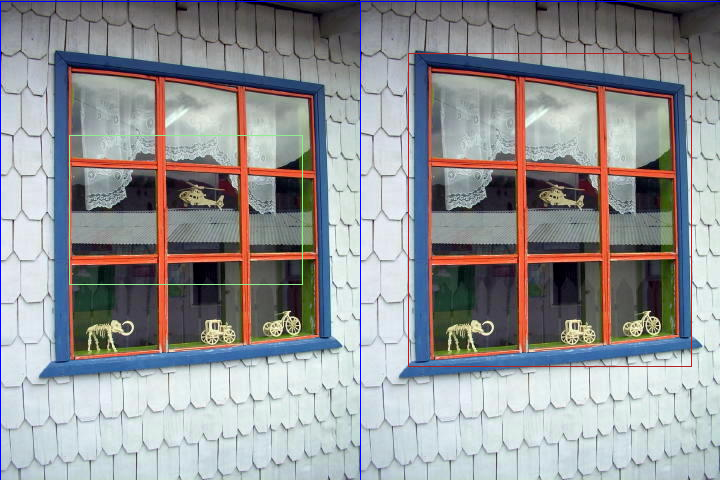

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
the sand


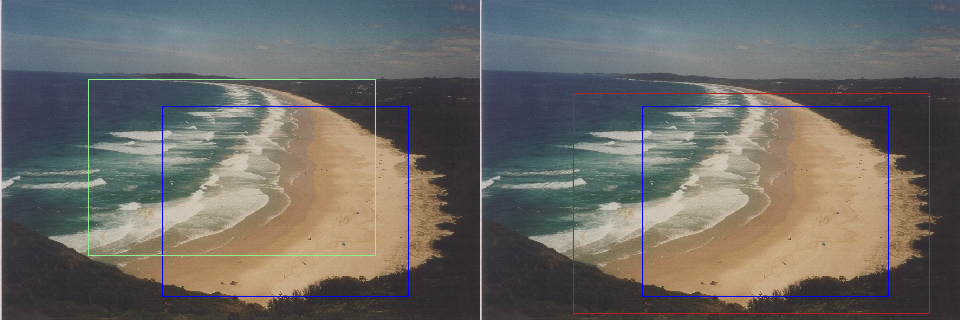

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
sky


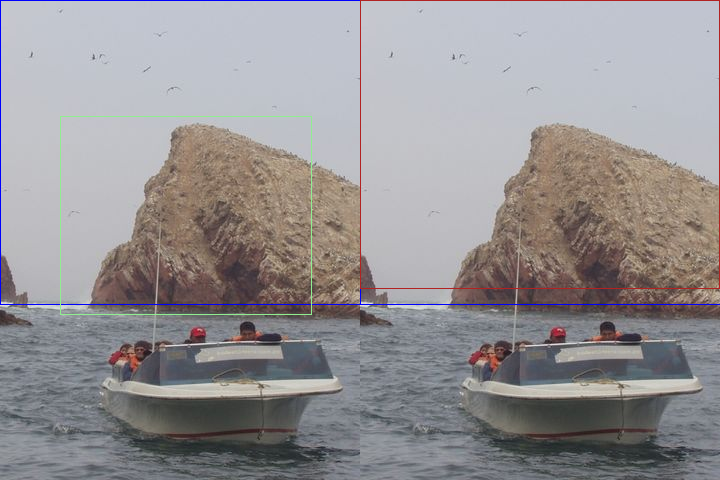

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
man


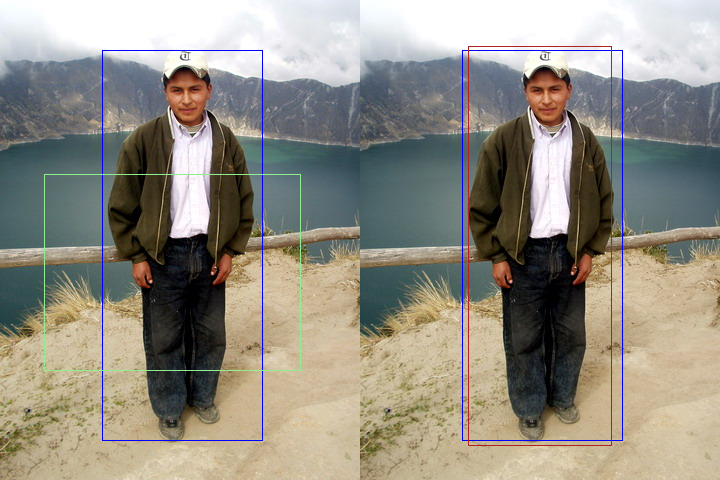

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
kid


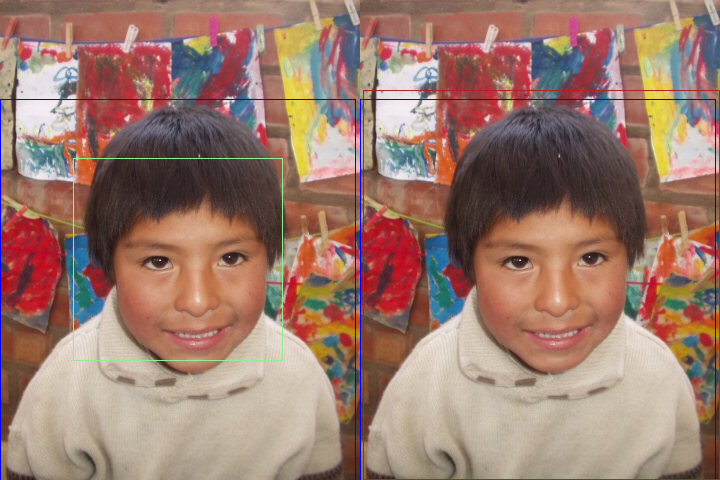

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
traincar ceiling


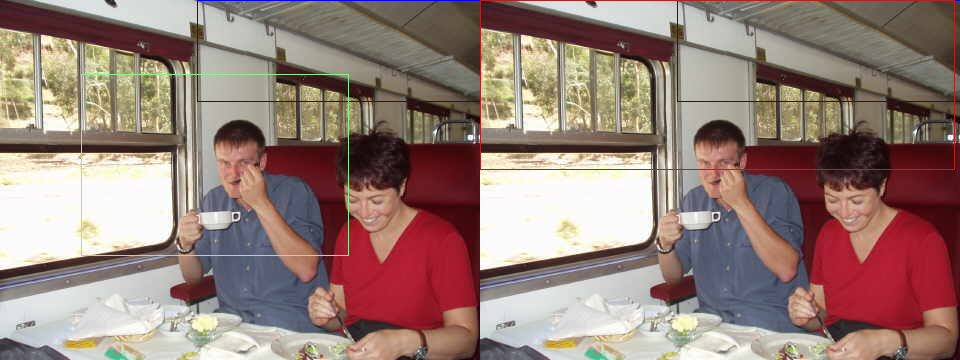

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
mountain


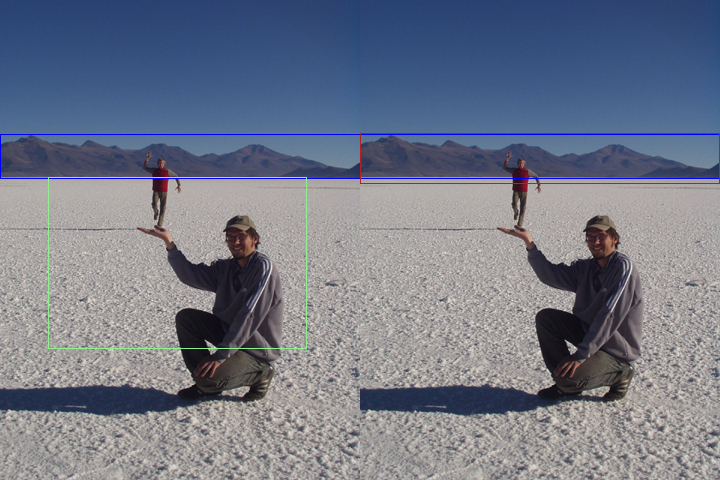

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
ruins


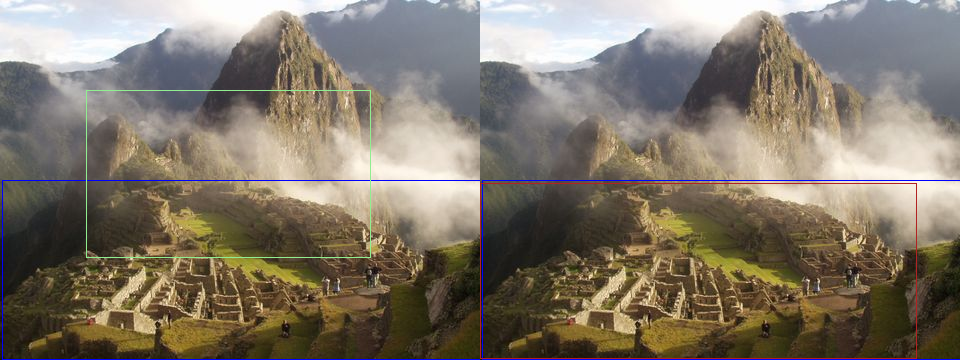

exp004 (left, green) and exp003 (right, red) comparision. INTRINSIC. HITS=0.
chair


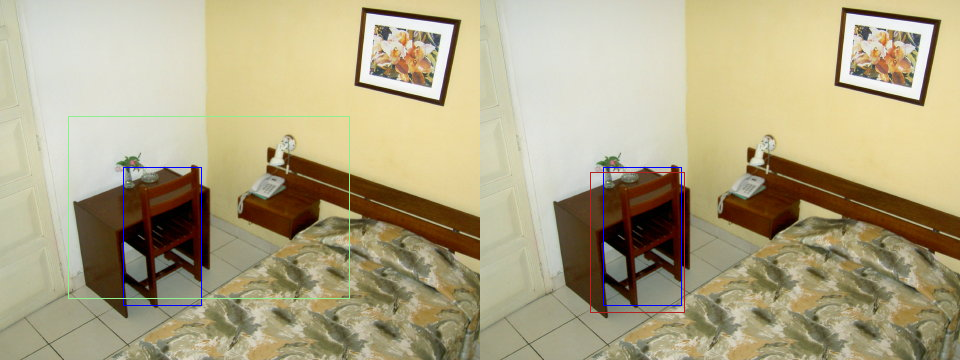

In [83]:
for rec_cls in ["spatial", "ordinal", "relational", "intrinsic"]:
    mask_counts = df_valid_results[rec_cls] == 1
    mask_hits = df_valid_results["hits"] == 0
    size_rec_cls_hits = df_valid_results[mask_counts & mask_hits].shape[0]
    df_sample_cls = (
        df_valid_results[mask_counts & mask_hits].sample(
            min(10, size_rec_cls_hits), random_state=42
        )
    )
    for _, row in df_sample_cls.loc[:, ["bbox_raw", "bbox_pred", "bbox_pred_exp003", "img_filename", "expr"]].iterrows():
        im = Image.open(f"{BASE_PATH}{row['img_filename']}")
        im = draw_bounding_boxes(im, [row['bbox_raw']], fmt="xyxy", color="blue")
        im2 = im.copy()
        im = draw_bounding_boxes(im, [row['bbox_pred']], fmt="xyxy", color="lightgreen")
        im2 = draw_bounding_boxes(im2, [row['bbox_pred_exp003']], fmt="xyxy", color="firebrick")
        print(f"exp004 (left, green) and exp003 (right, red) comparision. {rec_cls.upper()}. HITS=0.")
        print(row['expr'])
        get_concat_h(im, im2).show()